In [4]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

import warnings
import re
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, classification_report, confusion_matrix, ConfusionMatrixDisplay
warnings.filterwarnings("ignore") 
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)


from feature_engine.encoding import OrdinalEncoder, OneHotEncoder
from feature_engine.imputation import RandomSampleImputer
from xgboost import XGBClassifier
from sklearn.preprocessing import LabelEncoder
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import VotingClassifier, RandomForestClassifier, GradientBoostingClassifier, ExtraTreesClassifier

## Data load

In [5]:
df = pd.read_csv('/Users/katana/Desktop/SBAnational.csv', low_memory=False)

In [6]:
categorical_vars = [
    'State',
    'Bank'
]

In [7]:
binary_vars = [
    'LowDoc',
    'RevLineCr'
]


In [8]:
target = 'MIS_Status'

In [82]:
df['MIS_Status']

0          P I F
1          P I F
2          P I F
3          P I F
4          P I F
5          P I F
6         CHGOFF
7          P I F
8          P I F
9          P I F
10         P I F
11         P I F
12         P I F
13         P I F
14         P I F
15         P I F
16         P I F
17         P I F
18         P I F
19         P I F
20         P I F
21         P I F
22         P I F
23         P I F
24         P I F
25         P I F
26         P I F
27         P I F
28         P I F
29         P I F
30         P I F
31         P I F
32         P I F
33         P I F
34         P I F
35         P I F
36        CHGOFF
37         P I F
38         P I F
39         P I F
40         P I F
41         P I F
42         P I F
43        CHGOFF
44         P I F
45         P I F
46         P I F
47         P I F
48         P I F
49         P I F
50         P I F
51         P I F
52         P I F
53         P I F
54         P I F
55         P I F
56         P I F
57         P I F
58        CHGO

In [83]:
log_vars = [
    'NoEmp',
    'CreateJob',
    'RetainedJob'
]

In [10]:
miss_data_vars = [
    'State',
    'LowDoc'
]

In [11]:
def clean_money_columns(df, columns):
    '''
    Приводит значения в колонках с денежными выражениями к простым float.
    columns - список переменных
    '''
    for col in columns:
        if col not in df.columns:
            continue
        
        df[col] = (
            df[col]
            .astype(str)
            .str.strip()
            .str.replace(r"[^\d\.-]", "", regex=True)  
            .replace("", np.nan)                     
            .astype(float)
        )
    return df

In [12]:
money_cols = ["ChgOffPrinGr", "SBA_Appv", "GrAppv", "DisbursementGross"]

In [13]:
df = clean_money_columns(df, money_cols)

In [14]:
df['Bankrisk'] = df['GrAppv'] - df['SBA_Appv']

## Drop raws with wrong 'MIS_Status' base on 'ChgOffPrinGr' var

Переменная 'ChgOffPrinGr' по сути является прямым указателем на 'MIS_Status'. так как это сумма кредита (или его часть), признанная банком безнадёжной к взысканию и списанная как убыток. соответственно если появляется такая запись, следовательно статус кредита должен быть 'Не выплачен'.

Исходя из вышесказанного, проанлизировав переменную мы обнаружили несоответствие обозначения статуса кредита, которое нужно исправить. 
687 значений без задолженности обозначены как 'Не выплачен'
4884 значений имея задолженности обозначены как 'выплачен'
Причиной этому может быть задержки в обновлении базы данных, либо сбои или ошибки оператора.

Достоверность данных строк нельзя проверить точно, для чистоты обучения принято решение - удалить данные строки из тренировочного набора.

---
</br>

In [15]:
(df.loc[(df['ChgOffPrinGr'] == 0), 'MIS_Status']).value_counts()

MIS_Status
P I F     734725
CHGOFF       687
Name: count, dtype: int64

In [16]:
(df.loc[(df['ChgOffPrinGr'] > 0), 'MIS_Status']).value_counts()

MIS_Status
CHGOFF    156871
P I F       4884
Name: count, dtype: int64

In [17]:
mask = (
    ((df['ChgOffPrinGr'] == 0) & (df['MIS_Status'] == 'CHGOFF')) |
    ((df['ChgOffPrinGr'] > 0) & (df['MIS_Status'] == 'P I F'))
)

df = df.loc[~mask].copy()


In [18]:
df['MIS_Status'].value_counts()

MIS_Status
P I F     734725
CHGOFF    156871
Name: count, dtype: int64

In [19]:
(df.loc[(df['MIS_Status'].isnull()), 'ChgOffPrinGr'])

343            0.0
611       144461.0
738            0.0
740       142666.0
833            0.0
897            0.0
1051           0.0
1115           0.0
2119           0.0
3005           0.0
3083           0.0
3272           0.0
3910           0.0
4107           0.0
4588           0.0
4631           0.0
6569       18775.0
7659           0.0
8314           0.0
9519           0.0
9602      133365.0
10135          0.0
10412       6642.0
11023          0.0
11824        568.0
13300          0.0
13507       7380.0
15254       7722.0
15266        557.0
15547          0.0
16474          0.0
16630        199.0
17031          0.0
17038          0.0
17047          0.0
17074          0.0
17373          0.0
17377          0.0
17379          0.0
17531          0.0
17585          0.0
17718          0.0
17757          0.0
17770          0.0
17907       4390.0
17971          0.0
17994          0.0
18142       7534.0
18366          0.0
18407          0.0
18411          0.0
18429          0.0
18449       

Так же целевая переменная содержит пустые значения, по выше изложенной логике, есть два варианта - сделать предположение и заполнить пустые значения исходя из переменной 'ChgOffPrinGr', либо удалить пустые значения. Так как это целевая переменная, и нет полной уверености в данной гипотезе, а так же в достаточном количестве остаточных данных, решено удалить эти значения.

---
</br>

In [20]:
df = df.loc[(~df['MIS_Status'].isnull())]

## 'BalanceGross'

In [21]:
df['BalanceGross'].value_counts()

BalanceGross
$0.00           891582
$12,750.00           1
$827,875.00          1
$25,000.00           1
$37,100.00           1
$43,127.00           1
$84,617.00           1
$1,760.00            1
$115,820.00          1
$996,262.00          1
$395,476.00          1
$41,509.00           1
$600.00              1
$9,111.00            1
$96,908.00           1
Name: count, dtype: int64

Переменная 'BalanceGross' квазиконстантная переменная, доля одной категории составляет 99%. Переменная будет удалена

---
</br>

## 'NAICS'

In [22]:
df['NAICS'].head(10)

0    451120
1    722410
2    621210
3         0
4         0
5    332721
6         0
7    811118
8    721310
9         0
Name: NAICS, dtype: int64

кодировка отрасли в переменной 'NAICS' можно сократить до первых двух цифр, обобщив в наиболее крупные категории. Список категорий взят из Министерства торговли США (точнее - федеральное статистическое бюро)

---
</br>

In [23]:
def group_by_first2_numeric(df, col):
    first2 = (
        df[col]
        .astype("Int64")
        .astype(str)
        .str.lstrip("-")
        .str[:2]
        .astype("Int64")
    )
    def mapper(x):
        if pd.isna(x):
            return 81
        if x in {11, 21, 22, 23, 42, 51, 52, 53, 54, 55, 56, 61, 62, 71, 72, 92}:
            return int(x)
        if 31 <= x <= 33:
            return 33
        if 44 <= x <= 45:
            return 45
        if 48 <= x <= 49:
            return 49
        return 81

    df[col] = first2.map(mapper)
    return df

In [24]:
df = group_by_first2_numeric(df, "NAICS")

## 'NewExist' var

In [25]:
df['NewExist'].value_counts()

NewExist
1.0    639762
2.0    250678
0.0      1022
Name: count, dtype: int64

In [26]:
(df.loc[(df['NewExist'] == 0.0), 'MIS_Status']).value_counts()

MIS_Status
P I F     961
CHGOFF     61
Name: count, dtype: int64

In [27]:
df = df.loc[df['NewExist'] != 0.0]

In [28]:
df['NewExist'] = df['NewExist'].astype('Int64')

Переменная 'NewExist' отображает информацию о сроке существования бизнеса. если бизнесу меньше 2х лет, то он считается 'новым'.
Согласно приложению, новый бизнес обозначался как 2, старый как 1. Но в нашем датасете значения имеют вид 1.0 / 2.0
Помимо этого у нас имеются 1034 строк помеченных как 0.0, из всего вышесказанного делаем предположения, что при переносе данных или кодировании, пустые значения были помечены как 0.0
Достоверность данных строк нельзя проверить точно, для чистоты обучения принято решение - удалить данные строки из тренировочного набора

---
</br>

## 'RevLineCr'

In [29]:
df['RevLineCr'].value_counts()

RevLineCr
N    415760
0    255981
Y    199277
T     14985
1        22
R        14
`        11
2         6
C         2
3         1
,         1
7         1
A         1
5         1
.         1
4         1
-         1
Q         1
Name: count, dtype: int64

Переменная 'RevLineCr' по описанию Revolving line of credit: Y-Yes, N-No. По факту имеем категории схожие по смыслу Y/N, 0/1, T/F и некоторые отличные 'ошибки/отклонения'. Так как сходство очень явное, можно сделать предположение, что они возникли вследствие разных типов кодирования. Попробуем привести все к единому типу Y/N как в описании.

---
</br>

In [30]:
def clean_revlinecr(
    df: pd.DataFrame,
    col: str = "RevLineCr",
    valid_values: tuple = ("N", "Y"),
    drop_invalid: bool = True
) -> pd.DataFrame:
    """
    Нормализует признак RevLineCr к значениям 'Y' / 'N'
    и при необходимости удаляет некорректные строки.

    Parameters
    ----------
    df : pd.DataFrame
        Исходный DataFrame
    col : str
        Название колонки (по умолчанию 'RevLineCr')
    valid_values : tuple
        Допустимые значения после нормализации
    drop_invalid : bool
        Удалять ли строки с некорректными значениями

    Returns
    -------
    pd.DataFrame
        Очищенный DataFrame
    """

    df = df.copy()

    # Нормализация значений
    mapping = {
        '0': 'N',
        'N': 'N',
        '1': 'Y',
        'T': 'Y',
        'Y': 'Y'
    }

    df[col] = (
        df[col]
        .astype(str)
        .str.upper()
        .str.strip()
        .map(mapping)
    )

    # Удаление строк с некорректными значениями
    if drop_invalid:
        df = df[df[col].isin(valid_values)]

    return df

In [31]:
df = clean_revlinecr(df)

In [32]:
print("\nПосле очистки:")
print(df['RevLineCr'].value_counts(dropna=False))


После очистки:
RevLineCr
N    671741
Y    214284
Name: count, dtype: int64


In [33]:
def make_target(
    df: pd.DataFrame,
    source_col: str = "MIS_Status",
    target_col: str = "target",
    positive_class: str = "CHGOFF"
) -> pd.DataFrame:
    """
    Создаёт бинарный target для задачи кредитного дефолта.

    Parameters
    ----------
    df : pd.DataFrame
        Исходный DataFrame
    source_col : str
        Колонка с исходным статусом кредита
    target_col : str
        Название новой target-колонки
    positive_class : str
        Значение, которое считается дефолтом (1)

    Returns
    -------
    pd.DataFrame
        DataFrame с добавленной колонкой target
    """

    df = df.copy()

    # Нормализация текстовых значений
    df[source_col] = (
        df[source_col]
        .astype(str)
        .str.upper()
        .str.strip()
    )

    # Бинарный таргет
    df[target_col] = (df[source_col] == positive_class).astype(int)

    return df

In [34]:
df = make_target(df)

df["target"].value_counts(normalize=True)

target
0    0.823143
1    0.176857
Name: proportion, dtype: float64

In [35]:
def add_city_risk_group(
    df: pd.DataFrame,
    city_col: str = "City",
    target_col: str = "target",
    min_loans: int = 50,
    n_groups: int = 3,
    labels: list = None
) -> pd.DataFrame:
    """
    Добавляет категориальный признак CityRiskGroup
    на основе дефолтности по городам.

    Parameters
    ----------
    df : pd.DataFrame
        Исходный DataFrame
    city_col : str
        Колонка с названием города
    target_col : str
        Бинарный таргет (1 = дефолт)
    min_loans : int
        Минимальное число кредитов для учёта города
    n_groups : int
        Количество риск-групп (обычно 3)
    labels : list
        Названия групп риска

    Returns
    -------
    pd.DataFrame
        DataFrame с колонкой CityRiskGroup
    """

    if labels is None:
        labels = ['LOW_RISK', 'MEDIUM_RISK', 'HIGH_RISK']

    df = df.copy()

    # 1. Агрегация по городам
    city_stats = (
        df.groupby(city_col)
          .agg(
              TotalLoans=(target_col, 'count'),
              DefaultRate=(target_col, 'mean')
          )
          .reset_index()
    )

    # 2. Фильтр по минимальному количеству наблюдений
    city_stats = city_stats[city_stats['TotalLoans'] >= min_loans]

    # 3. Разбиение на риск-группы
    city_stats['CityRiskGroup'] = pd.qcut(
        city_stats['DefaultRate'],
        q=n_groups,
        labels=labels
    )

    # 4. Мерж обратно
    df = df.merge(
        city_stats[[city_col, 'CityRiskGroup']],
        on=city_col,
        how='left'
    )

    return df

In [36]:
df = add_city_risk_group(df)

In [37]:
print(df['CityRiskGroup'].value_counts(dropna=False))

CityRiskGroup
MEDIUM_RISK    271397
HIGH_RISK      248413
LOW_RISK       190306
NaN            175909
Name: count, dtype: int64


#### Для переменной City была применена группировка по уровню риска дефолта. Города были разделены на три категории (низкий, средний и высокий риск) на основе исторической доли дефолтов при условии минимального количества наблюдений. Это позволило снизить кардинальность признака и сохранить интерпретируемый риск-сигнал для модели.

In [38]:
def add_sba_ratio(
    df: pd.DataFrame,
    sba_col: str = "SBA_Appv",
    gr_col: str = "GrAppv",
    ratio_col: str = "SBA_ratio"
) -> pd.DataFrame:
    """
    Создаёт признак отношения SBA_Appv / GrAppv.

    Обрабатывает деление на ноль, inf и NaN.

    Parameters
    ----------
    df : pd.DataFrame
        Исходный DataFrame
    sba_col : str
        Колонка с суммой SBA
    gr_col : str
        Колонка с общей суммой кредита
    ratio_col : str
        Название новой ratio-колонки

    Returns
    -------
    pd.DataFrame
        DataFrame с добавленной колонкой ratio
    """

    df = df.copy()

    df[ratio_col] = df[sba_col] / df[gr_col]

    # Убираем inf / -inf → NaN
    df[ratio_col] = df[ratio_col].replace([np.inf, -np.inf], np.nan)

    return df

In [39]:
df = add_sba_ratio(df)

#### Для снижения мультиколлинеарности и повышения интерпретируемости была создана производная переменная SBA_ratio, отражающая долю гарантии SBA в общей сумме кредита. Данная переменная имеет прямой бизнес-смысл и позволяет модели учитывать не только размер кредита, но и уровень перераспределения риска между банком и SBA.

In [40]:
var_to_drop = ['LoanNr_ChkDgt',
               'Name',
               'Zip',
               'BankState',
               'ApprovalDate',
               'ApprovalFY',
               'ChgOffPrinGr', # прямой указатель к таргет переменной
               'ChgOffDate', # 82 % пустых значений
               'DisbursementDate', 
               'DisbursementGross', # высокая корляция с GrAppv, SBA_Appv
               'SBA_Appv', 
               #'SBA_Appv', # высокая корляция с GrAppv, DisbursementGross
               'BalanceGross', # потому что квазиконстантная переменная
               'MIS_Status',
               'City'
            ]

## New var 'Bankrisk'

#### В нашем датасете три переменных сильно кореллируют между собой. переменную 'DisbursementGross' дропнем полностью, а из двух оставшизся методом арифметического вычитания  создадим новую переменную, которая будет отображать разницу между суммой которую одобрил на выдачу банк и суммой которую одобрила SBA. Новая переменная по сути является суммой риска самого банка-кредитора

## Train/Test split

In [41]:
X = df.drop('target', axis = 1)
y = df['target']

In [42]:
X_train, X_test, y_train, y_test = train_test_split(X,
                                                   y,
                                                   test_size=0.3,
                                                   stratify=y,
                                                   random_state=45)

In [43]:
# Drop unnecessary vars

X_train = X_train.drop(var_to_drop, axis = 1)
X_test = X_test.drop(var_to_drop, axis = 1)

In [44]:
# Процент пропусков по колонкам
missing_percent = X_train.isnull().sum() / len(df) * 100
missing_percent = X_test.isnull().sum() / len(df) * 100
# Округлим до двух знаков
missing_percent = missing_percent.round(2)
# Показать
print(missing_percent)

State            0.00
Bank             0.05
NAICS            0.00
Term             0.00
NoEmp            0.00
NewExist         0.00
CreateJob        0.00
RetainedJob      0.00
FranchiseCode    0.00
UrbanRural       0.00
RevLineCr        0.00
LowDoc           0.09
GrAppv           0.00
Bankrisk         0.00
CityRiskGroup    5.95
SBA_ratio        0.00
dtype: float64


## !!!!

In [81]:
# use in pipeline feature engine logarithmic transformer 

In [45]:
# Logorifm variables with right-skewed distribution

(X_train[log_vars] < 0).sum()

for var in log_vars:
    X_train[var] = np.log1p(X_train[var])
    X_test[var] = np.log1p(X_test[var])

In [46]:
# Создаём КОПИИ для безопасной работы
X_train_processed = X_train.copy()
X_test_processed = X_test.copy()
y_train_processed = y_train.copy()
y_test_processed = y_test.copy()

In [47]:
X_train_processed['LowDoc'].unique()

array(['N', 'Y', nan, 'S', 'C', '0', 'A', 'R', '1'], dtype=object)

In [48]:
print(X_train_processed['LowDoc'].value_counts(dropna=False))

LowDoc
N      540794
Y       75438
NaN      1771
0         872
C         501
S         428
A         349
R          63
1           1
Name: count, dtype: int64


In [ ]:
### !!!!   Manual encoding

In [49]:
valid_values = ['Y', 'N', '1', '0']

X_train_processed['LowDoc'] = X_train_processed['LowDoc'].where(
    X_train_processed['LowDoc'].isin(valid_values),
    np.nan
)

X_test_processed['LowDoc'] = X_test_processed['LowDoc'].where(
    X_test_processed['LowDoc'].isin(valid_values),
    np.nan
)

for var in binary_vars:
    if var in X_train_processed.columns:
        # Проверяем тип данных
        if X_train_processed[var].dtype == 'object':
            X_train_processed[var] = X_train_processed[var].replace({'N':0,'Y':1})
            X_test_processed[var] = X_test_processed[var].replace({'N':0,'Y':1})

            print(f" {var}: N/Y → 0/1")
        else:
            print(f" {var}: уже числовой")

 LowDoc: N/Y → 0/1
 RevLineCr: N/Y → 0/1


In [50]:
# missing data imputation
# Проверяем пропуски ДО
print("Пропуски ДО imputer:")
missing_before = X_train_processed.isnull().sum()
missing_before_df = missing_before[missing_before > 0]
print(missing_before_df)

if len(miss_data_vars) > 0:
    imputer = RandomSampleImputer(variables=miss_data_vars, random_state=1)
    X_train_processed = imputer.fit_transform(X_train_processed)
    X_test_processed = imputer.transform(X_test_processed)
    print(f"\RandomSampleImputer применён к {len(miss_data_vars)} переменным")
else:
    print("Пропусков нет в числовых")

# Проверка ПОСЛЕ
print("\nПропуски ПОСЛЕ RandomSampleImputer:")
missing_after = X_train_processed.isnull().sum()
missing_after_df = missing_after[missing_after > 0]
if missing_after_df.sum() > 0:
    print(missing_after_df)
    print(f"\Всего пропусков: {missing_after_df.sum()}")
    
    # Заполняем оставшиеся пропуски
    print("Заполняем оставшиеся пропуски...")
    
    # Для числовых - медиана
    numeric_with_missing = X_train_processed.select_dtypes(include=[np.number]).columns[
        X_train_processed.select_dtypes(include=[np.number]).isnull().any()
    ].tolist()
    
    if len(numeric_with_missing) > 0:
        print(f"   Числовые с пропусками: {numeric_with_missing}")
        for col in numeric_with_missing:
            median_val = X_train_processed[col].median()
            X_train_processed[col].fillna(median_val, inplace=True)
            X_test_processed[col].fillna(median_val, inplace=True)
        print(f"   Заполнено медианой")
    
    # Для категориальных - мода
    categorical_with_missing = X_train_processed.select_dtypes(exclude=[np.number]).columns[
        X_train_processed.select_dtypes(exclude=[np.number]).isnull().any()
    ].tolist()
    
    if len(categorical_with_missing) > 0:
        print(f"   Категориальные с пропусками: {categorical_with_missing}")
        for col in categorical_with_missing:
            mode_val = X_train_processed[col].mode()[0]
            X_train_processed[col].fillna(mode_val, inplace=True)
            X_test_processed[col].fillna(mode_val, inplace=True)
        print(f"   Заполнено модой")
    
else:
    print("Пропусков нет")

# Финальная проверка пропусков
missing_final = X_train_processed.isnull().sum().sum()
print(f"\nПРОПУСКОВ ПОСЛЕ ВСЕХ ОПЕРАЦИЙ: {missing_final}")

Пропуски ДО imputer:
State                11
Bank               1044
NewExist             94
LowDoc             3112
CityRiskGroup    123232
dtype: int64
\RandomSampleImputer применён к 2 переменным

Пропуски ПОСЛЕ RandomSampleImputer:
Bank               1044
NewExist             94
CityRiskGroup    123232
dtype: int64
\Всего пропусков: 124370
Заполняем оставшиеся пропуски...
   Числовые с пропусками: ['NewExist']
   Заполнено медианой
   Категориальные с пропусками: ['Bank', 'CityRiskGroup']
   Заполнено модой

ПРОПУСКОВ ПОСЛЕ ВСЕХ ОПЕРАЦИЙ: 0


In [79]:
# Процент пропусков по колонкам
missing_percent_train = X_train_processed.isnull().sum() / len(df) * 100
missing_percent_test = X_test_processed.isnull().sum() / len(df) * 100
# Округлим до двух знаков
missing_percent = missing_percent.round(2)
# Показать
print(missing_percent_train, missing_percent_test)

State            0.0
Bank             0.0
NAICS            0.0
Term             0.0
NoEmp            0.0
NewExist         0.0
CreateJob        0.0
RetainedJob      0.0
FranchiseCode    0.0
UrbanRural       0.0
RevLineCr        0.0
LowDoc           0.0
GrAppv           0.0
Bankrisk         0.0
CityRiskGroup    0.0
SBA_ratio        0.0
dtype: float64 State            0.0
Bank             0.0
NAICS            0.0
Term             0.0
NoEmp            0.0
NewExist         0.0
CreateJob        0.0
RetainedJob      0.0
FranchiseCode    0.0
UrbanRural       0.0
RevLineCr        0.0
LowDoc           0.0
GrAppv           0.0
Bankrisk         0.0
CityRiskGroup    0.0
SBA_ratio        0.0
dtype: float64


In [52]:
#le_target = LabelEncoder()
#y_train_processed = le_target.fit_transform(y_train_processed)
#y_test_processed = le_target.transform(y_test_processed)

#print(f" Target закодирован: {le_target.classes_}")

In [53]:
X_train_processed.head()

,State,Bank,NAICS,Term,NoEmp,NewExist,CreateJob,RetainedJob,FranchiseCode,UrbanRural,RevLineCr,LowDoc,GrAppv,Bankrisk,CityRiskGroup,SBA_ratio
366183,OH,JPMORGAN CHASE BANK NATL ASSOC,49,84,1.098612,2,0.000000,1.098612,0,1,0,0,14500.0,7250.0,LOW_RISK,0.50
738104,ID,WELLS FARGO BANK NATL ASSOC,23,84,0.693147,1,0.000000,0.000000,1,0,0,1,40000.0,4000.0,LOW_RISK,0.90
315356,CT,INDEPENDENCE BANK,81,252,1.791759,1,0.000000,0.000000,1,2,0,0,300000.0,75000.0,MEDIUM_RISK,0.75
772953,PA,CITIZENS BANK OF PENNSYLVANIA,81,180,1.945910,2,0.000000,0.000000,1,0,0,0,500000.0,125000.0,LOW_RISK,0.75
696042,CA,BBCN BANK,51,84,1.791759,1,1.098612,1.791759,1,0,0,0,5000.0,750.0,MEDIUM_RISK,0.85


In [54]:
categorical_vars_clean = [
    col for col in categorical_vars
    if X_train_processed[col].dtype == 'object'
]

In [ ]:
### Manual encoding???

In [55]:
def encode_city_risk_group(
    df: pd.DataFrame,
    col: str = 'CityRiskGroup'
) -> pd.DataFrame:
    """
    Кодирует категориальный признак CityRiskGroup в ordinal формат.

    LOW_RISK    → 0
    MEDIUM_RISK → 1
    HIGH_RISK   → 2
    """

    df = df.copy()

    mapping = {
        'LOW_RISK': 0,
        'MEDIUM_RISK': 1,
        'HIGH_RISK': 2
    }

    df[col] = (
        df[col]
        .astype(str)
        .str.upper()
        .str.strip()
        .map(mapping)
    )

    return df

In [56]:
X_train_processed = encode_city_risk_group(X_train_processed)
X_test_processed  = encode_city_risk_group(X_test_processed)

In [57]:
X_train_processed['CityRiskGroup'].value_counts()

CityRiskGroup
1    313073
2    173586
0    133558
Name: count, dtype: int64

In [58]:
oe = OrdinalEncoder(
    variables=categorical_vars,
    encoding_method="arbitrary",
    missing_values="ignore",
    unseen="encode"
)

X_train_processed[categorical_vars] = (
    X_train_processed[categorical_vars].fillna('unknown')
)
X_test_processed[categorical_vars] = (
    X_test_processed[categorical_vars].fillna('unknown')
)

X_train_processed = oe.fit_transform(X_train_processed)
X_test_processed = oe.transform(X_test_processed)

In [59]:
# Финальная проверка
print("\n" + "="*70)
print("ФИНАЛЬНАЯ ПРОВЕРКА ДАННЫХ")
print("="*70)
print(f"X_train shape: {X_train_processed.shape}")
print(f"X_test shape: {X_test_processed.shape}")
print("Пропуски в X_train (%):")
print(X_train_processed.isnull().mean() * 100)
print("\nПропуски в X_test (%):")
print(X_test_processed.isnull().mean() * 100)
print(f"Нечисловых колонок: {len(X_train_processed.select_dtypes(exclude=[np.number]).columns)}")


ФИНАЛЬНАЯ ПРОВЕРКА ДАННЫХ
X_train shape: (620217, 16)
X_test shape: (265808, 16)
Пропуски в X_train (%):
State            0.0
Bank             0.0
NAICS            0.0
Term             0.0
NoEmp            0.0
NewExist         0.0
CreateJob        0.0
RetainedJob      0.0
FranchiseCode    0.0
UrbanRural       0.0
RevLineCr        0.0
LowDoc           0.0
GrAppv           0.0
Bankrisk         0.0
CityRiskGroup    0.0
SBA_ratio        0.0
dtype: float64

Пропуски в X_test (%):
State            0.0
Bank             0.0
NAICS            0.0
Term             0.0
NoEmp            0.0
NewExist         0.0
CreateJob        0.0
RetainedJob      0.0
FranchiseCode    0.0
UrbanRural       0.0
RevLineCr        0.0
LowDoc           0.0
GrAppv           0.0
Bankrisk         0.0
CityRiskGroup    0.0
SBA_ratio        0.0
dtype: float64
Нечисловых колонок: 1


In [60]:
X_train_processed.head()

,State,Bank,NAICS,Term,NoEmp,NewExist,CreateJob,RetainedJob,FranchiseCode,UrbanRural,RevLineCr,LowDoc,GrAppv,Bankrisk,CityRiskGroup,SBA_ratio
366183,0,0,49,84,1.098612,2,0.000000,1.098612,0,1,0,0,14500.0,7250.0,0,0.50
738104,1,1,23,84,0.693147,1,0.000000,0.000000,1,0,0,1,40000.0,4000.0,0,0.90
315356,2,2,81,252,1.791759,1,0.000000,0.000000,1,2,0,0,300000.0,75000.0,1,0.75
772953,3,3,81,180,1.945910,2,0.000000,0.000000,1,0,0,0,500000.0,125000.0,0,0.75
696042,4,4,51,84,1.791759,1,1.098612,1.791759,1,0,0,0,5000.0,750.0,1,0.85


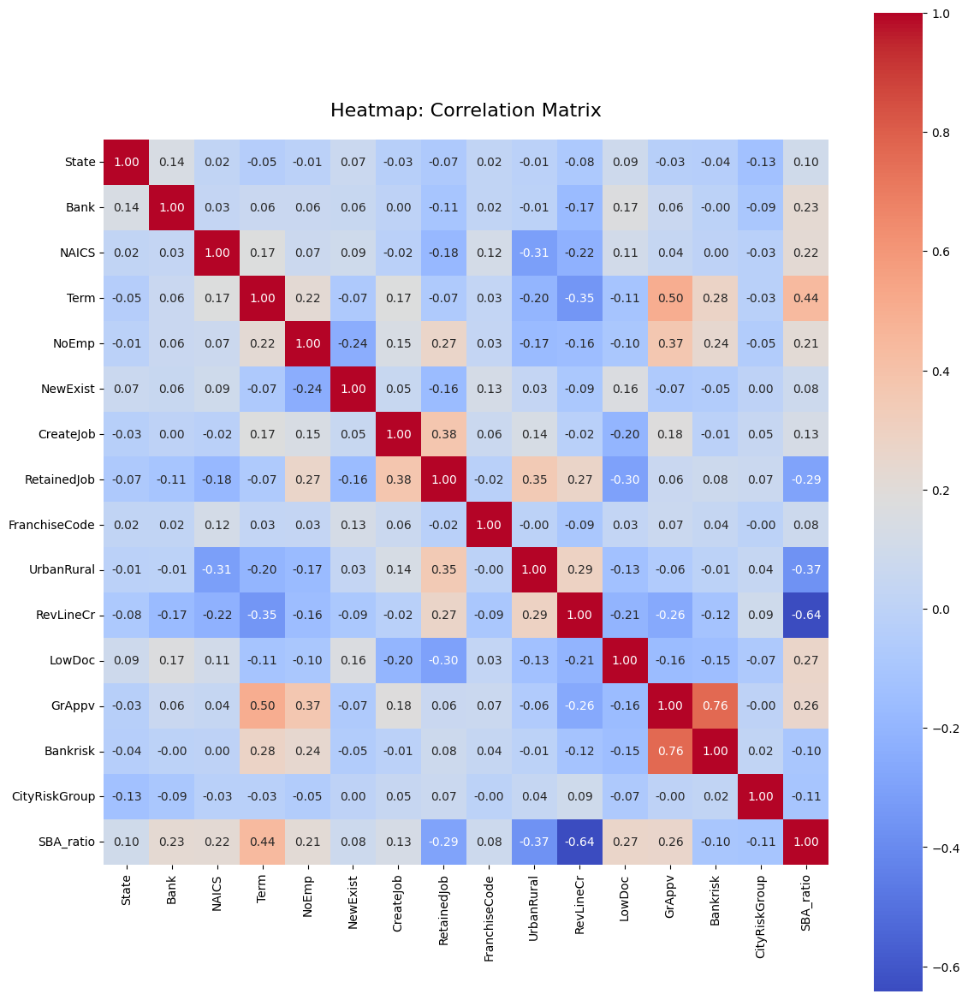

In [61]:
plt.figure(figsize=(12, 12))  # Adjusted figure size for better readability

plt.title("Heatmap: Correlation Matrix", fontsize=16, pad=20)

sns.heatmap(X_train_processed.corr(), annot=True, cbar=True, fmt=".2f", cmap="coolwarm", square=True)

plt.tight_layout()

plt.show()

In [62]:
X_train_processed['LowDoc'].unique()

array([0, 1, '0', '1'], dtype=object)

In [63]:
X_train_processed['LowDoc'] = X_train_processed['LowDoc'].astype(str).astype(int)
X_test_processed['LowDoc'] = X_test_processed['LowDoc'].astype(str).astype(int)

In [64]:
X_train_processed['CityRiskGroup'] = X_train_processed['CityRiskGroup'].astype(str).astype(int)
X_test_processed['CityRiskGroup'] = X_test_processed['CityRiskGroup'].astype(str).astype(int)

In [65]:
X_train_processed.info()

<class 'pandas.core.frame.DataFrame'>
Index: 620217 entries, 366183 to 783881
Data columns (total 16 columns):
 #   Column         Non-Null Count   Dtype  
---  ------         --------------   -----  
 0   State          620217 non-null  int64  
 1   Bank           620217 non-null  int64  
 2   NAICS          620217 non-null  int64  
 3   Term           620217 non-null  int64  
 4   NoEmp          620217 non-null  float64
 5   NewExist       620217 non-null  Int64  
 6   CreateJob      620217 non-null  float64
 7   RetainedJob    620217 non-null  float64
 8   FranchiseCode  620217 non-null  int64  
 9   UrbanRural     620217 non-null  int64  
 10  RevLineCr      620217 non-null  int64  
 11  LowDoc         620217 non-null  int64  
 12  GrAppv         620217 non-null  float64
 13  Bankrisk       620217 non-null  float64
 14  CityRiskGroup  620217 non-null  int64  
 15  SBA_ratio      620217 non-null  float64
dtypes: Int64(1), float64(6), int64(9)
memory usage: 81.0 MB


In [66]:
print("\n" + "="*70)
print("МОДЕЛЬ 1: XGBOOST")
print("="*70)

xgb = XGBClassifier(
    n_estimators=800,
    learning_rate=0.05,
    max_depth=7,
    subsample=0.8,
    colsample_bytree=0.8,
    min_child_weight=10,
    gamma=0.1,
    reg_alpha=1.0,
    reg_lambda=5.0,
    eval_metric='auc',
    random_state=42,
    n_jobs=-1
)

xgb.fit(X_train_processed, y_train_processed)

# TRAIN
xgb_pred_train = xgb.predict(X_train_processed)
xgb_proba_train = xgb.predict_proba(X_train_processed)[:, 1]

# TEST
xgb_pred_test = xgb.predict(X_test_processed)
xgb_proba_test = xgb.predict_proba(X_test_processed)[:, 1]

print("\n=== TRAIN METRICS (XGBOOST) ===")
print("Confusion Matrix:")
print(confusion_matrix(y_train_processed, xgb_pred_train))
print("\nClassification Report:")
print(classification_report(y_train_processed, xgb_pred_train, digits=3))
print(f"ROC-AUC: {roc_auc_score(y_train_processed, xgb_proba_train):.3f}")
print(f"F1: {f1_score(y_train_processed, xgb_pred_train):.3f}")

print("\n=== TEST METRICS (XGBOOST) ===")
print("Confusion Matrix:")
print(confusion_matrix(y_test_processed, xgb_pred_test))
print("\nClassification Report:")
print(classification_report(y_test_processed, xgb_pred_test, digits=3))
print(f"ROC-AUC: {roc_auc_score(y_test_processed, xgb_proba_test):.3f}")
print(f"F1: {f1_score(y_test_processed, xgb_pred_test):.3f}")


МОДЕЛЬ 1: XGBOOST

=== TRAIN METRICS (XGBOOST) ===
Confusion Matrix:
[[502031   8496]
 [ 16903  92787]]

Classification Report:
              precision    recall  f1-score   support

           0      0.967     0.983     0.975    510527
           1      0.916     0.846     0.880    109690

    accuracy                          0.959    620217
   macro avg      0.942     0.915     0.927    620217
weighted avg      0.958     0.959     0.958    620217

ROC-AUC: 0.985
F1: 0.880

=== TEST METRICS (XGBOOST) ===
Confusion Matrix:
[[214779   4019]
 [  7889  39121]]

Classification Report:
              precision    recall  f1-score   support

           0      0.965     0.982     0.973    218798
           1      0.907     0.832     0.868     47010

    accuracy                          0.955    265808
   macro avg      0.936     0.907     0.920    265808
weighted avg      0.954     0.955     0.954    265808

ROC-AUC: 0.982
F1: 0.868


In [67]:
from catboost import CatBoostClassifier

print("\n" + "="*70)
print("МОДЕЛЬ 2: CATBOOST")
print("="*70)

cat = CatBoostClassifier(
    iterations=800,
    learning_rate=0.05,
    depth=6,
    loss_function='Logloss',
    eval_metric='AUC',
    random_seed=42,
    verbose=100
)

cat.fit(X_train_processed, y_train_processed)

# TRAIN
cat_pred_train = cat.predict(X_train_processed)
cat_proba_train = cat.predict_proba(X_train_processed)[:, 1]

# TEST
cat_pred_test = cat.predict(X_test_processed)
cat_proba_test = cat.predict_proba(X_test_processed)[:, 1]

print("\n=== TRAIN METRICS (CATBOOST) ===")
print("Confusion Matrix:")
print(confusion_matrix(y_train_processed, cat_pred_train))
print("\nClassification Report:")
print(classification_report(y_train_processed, cat_pred_train, digits=3))
print(f"ROC-AUC: {roc_auc_score(y_train_processed, cat_proba_train):.3f}")
print(f"F1: {f1_score(y_train_processed, cat_pred_train):.3f}")

print("\n=== TEST METRICS (CATBOOST) ===")
print("Confusion Matrix:")
print(confusion_matrix(y_test_processed, cat_pred_test))
print("\nClassification Report:")
print(classification_report(y_test_processed, cat_pred_test, digits=3))
print(f"ROC-AUC: {roc_auc_score(y_test_processed, cat_proba_test):.3f}")
print(f"F1: {f1_score(y_test_processed, cat_pred_test):.3f}")


МОДЕЛЬ 2: CATBOOST
0:	total: 79.6ms	remaining: 1m 3s
100:	total: 1.71s	remaining: 11.8s
200:	total: 3.37s	remaining: 10s
300:	total: 5s	remaining: 8.28s
400:	total: 6.61s	remaining: 6.58s
500:	total: 8.31s	remaining: 4.96s
600:	total: 9.95s	remaining: 3.29s
700:	total: 11.6s	remaining: 1.64s
799:	total: 13.3s	remaining: 0us

=== TRAIN METRICS (CATBOOST) ===
Confusion Matrix:
[[500163  10364]
 [ 19792  89898]]

Classification Report:
              precision    recall  f1-score   support

           0      0.962     0.980     0.971    510527
           1      0.897     0.820     0.856    109690

    accuracy                          0.951    620217
   macro avg      0.929     0.900     0.914    620217
weighted avg      0.950     0.951     0.951    620217

ROC-AUC: 0.981
F1: 0.856

=== TEST METRICS (CATBOOST) ===
Confusion Matrix:
[[214423   4375]
 [  8603  38407]]

Classification Report:
              precision    recall  f1-score   support

           0      0.961     0.980     0.971  

In [68]:
from sklearn.ensemble import RandomForestClassifier

print("\n" + "="*70)
print("МОДЕЛЬ 3: RANDOM FOREST")
print("="*70)

rf = RandomForestClassifier(
    n_estimators=500,
    max_depth=15,
    min_samples_split=10,
    min_samples_leaf=5,
    max_features='sqrt',
    class_weight='balanced',
    random_state=42,
    n_jobs=-1
)

rf.fit(X_train_processed, y_train_processed)

# TRAIN
rf_pred_train = rf.predict(X_train_processed)
rf_proba_train = rf.predict_proba(X_train_processed)[:, 1]

# TEST
rf_pred_test = rf.predict(X_test_processed)
rf_proba_test = rf.predict_proba(X_test_processed)[:, 1]

print("\n=== TRAIN METRICS (RANDOM FOREST) ===")
print(confusion_matrix(y_train_processed, rf_pred_train))
print(classification_report(y_train_processed, rf_pred_train, digits=3))
print(f"ROC-AUC: {roc_auc_score(y_train_processed, rf_proba_train):.3f}")
print(f"F1: {f1_score(y_train_processed, rf_pred_train):.3f}")

print("\n=== TEST METRICS (RANDOM FOREST) ===")
print(confusion_matrix(y_test_processed, rf_pred_test))
print(classification_report(y_test_processed, rf_pred_test, digits=3))
print(f"ROC-AUC: {roc_auc_score(y_test_processed, rf_proba_test):.3f}")
print(f"F1: {f1_score(y_test_processed, rf_pred_test):.3f}")


МОДЕЛЬ 3: RANDOM FOREST

=== TRAIN METRICS (RANDOM FOREST) ===
[[474201  36326]
 [  8942 100748]]
              precision    recall  f1-score   support

           0      0.981     0.929     0.954    510527
           1      0.735     0.918     0.817    109690

    accuracy                          0.927    620217
   macro avg      0.858     0.924     0.885    620217
weighted avg      0.938     0.927     0.930    620217

ROC-AUC: 0.981
F1: 0.817

=== TEST METRICS (RANDOM FOREST) ===
[[202275  16523]
 [  5066  41944]]
              precision    recall  f1-score   support

           0      0.976     0.924     0.949    218798
           1      0.717     0.892     0.795     47010

    accuracy                          0.919    265808
   macro avg      0.846     0.908     0.872    265808
weighted avg      0.930     0.919     0.922    265808

ROC-AUC: 0.972
F1: 0.795


In [69]:
from sklearn.ensemble import GradientBoostingClassifier

print("\n" + "="*70)
print("МОДЕЛЬ 5: GRADIENT BOOSTING (SKLEARN)")
print("="*70)

gb = GradientBoostingClassifier(
    n_estimators=500,
    learning_rate=0.05,
    max_depth=5,
    min_samples_split=10,
    min_samples_leaf=5,
    subsample=0.8,
    random_state=42
)

gb.fit(X_train_processed, y_train_processed)

# TRAIN
gb_pred_train = gb.predict(X_train_processed)
gb_proba_train = gb.predict_proba(X_train_processed)[:, 1]

# TEST
gb_pred_test = gb.predict(X_test_processed)
gb_proba_test = gb.predict_proba(X_test_processed)[:, 1]

print("\n=== TRAIN METRICS (GRADIENT BOOSTING) ===")
print(confusion_matrix(y_train_processed, gb_pred_train))
print(classification_report(y_train_processed, gb_pred_train, digits=3))
print(f"ROC-AUC: {roc_auc_score(y_train_processed, gb_proba_train):.3f}")
print(f"F1: {f1_score(y_train_processed, gb_pred_train):.3f}")

print("\n=== TEST METRICS (GRADIENT BOOSTING) ===")
print(confusion_matrix(y_test_processed, gb_pred_test))
print(classification_report(y_test_processed, gb_pred_test, digits=3))
print(f"ROC-AUC: {roc_auc_score(y_test_processed, gb_proba_test):.3f}")
print(f"F1: {f1_score(y_test_processed, gb_pred_test):.3f}")


МОДЕЛЬ 5: GRADIENT BOOSTING (SKLEARN)

=== TRAIN METRICS (GRADIENT BOOSTING) ===
[[500496  10031]
 [ 19340  90350]]
              precision    recall  f1-score   support

           0      0.963     0.980     0.971    510527
           1      0.900     0.824     0.860    109690

    accuracy                          0.953    620217
   macro avg      0.931     0.902     0.916    620217
weighted avg      0.952     0.953     0.952    620217

ROC-AUC: 0.982
F1: 0.860

=== TEST METRICS (GRADIENT BOOSTING) ===
[[214476   4322]
 [  8515  38495]]
              precision    recall  f1-score   support

           0      0.962     0.980     0.971    218798
           1      0.899     0.819     0.857     47010

    accuracy                          0.952    265808
   macro avg      0.930     0.900     0.914    265808
weighted avg      0.951     0.952     0.951    265808

ROC-AUC: 0.981
F1: 0.857


In [70]:
X_new = X_test_processed.sample(1, random_state=42)

In [71]:
print(X_new.shape)
print(X_new.columns)

(1, 16)
Index(['State', 'Bank', 'NAICS', 'Term', 'NoEmp', 'NewExist', 'CreateJob',
       'RetainedJob', 'FranchiseCode', 'UrbanRural', 'RevLineCr', 'LowDoc',
       'GrAppv', 'Bankrisk', 'CityRiskGroup', 'SBA_ratio'],
      dtype='object')


In [72]:
X_new = X_new[X_train_processed.columns]

In [73]:
def make_decision(model, X, name, t1=0.4, t2=0.7):
    """
    Функция принимает обученную модель и данные одного клиента
    и возвращает решение банка на основе вероятности дефолта.

    model — обученная модель (RandomForest, CatBoost, XGB и т.д.)
    X     — данные одного клиента (DataFrame с 1 строкой)
    name  — название модели (для вывода)
    t1    — порог для «выдать с ограничениями»
    t2    — порог для «отказ»
    """

    # Получаем вероятность дефолта (класс 1)
    # predict_proba -> [P(0), P(1)]
    # [:, 1] — вероятность дефолта
    # [0] — т.к. один клиент
    proba = model.predict_proba(X)[:, 1][0]

    # Логика принятия решения
    if proba > t2:
        decision = "ОТКАЗ"
    elif proba > t1:
        decision = "ВЫДАТЬ С ОГРАНИЧЕНИЯМИ"
    else:
        decision = "ВЫДАТЬ"

    print(f"\n{name}")
    print("-" * 40)
    print("Вероятность дефолта:", round(proba, 3))
    print("Решение банка:", decision)

    return proba, decision

In [74]:
make_decision(gb,  X_new, "Gradient Boosting")
make_decision(rf,  X_new, "Random Forest")
make_decision(cat, X_new, "CatBoost")
make_decision(xgb, X_new, "XGBoost")


Gradient Boosting
----------------------------------------
Вероятность дефолта: 0.058
Решение банка: ВЫДАТЬ

Random Forest
----------------------------------------
Вероятность дефолта: 0.744
Решение банка: ОТКАЗ

CatBoost
----------------------------------------
Вероятность дефолта: 0.049
Решение банка: ВЫДАТЬ

XGBoost
----------------------------------------
Вероятность дефолта: 0.096
Решение банка: ВЫДАТЬ


(0.09626404, 'ВЫДАТЬ')

In [75]:
from sklearn.preprocessing import StandardScaler

# копия — чтобы ничего не сломать
X_train_nn = X_train_processed.copy()
X_test_nn  = X_test_processed.copy()

scaler = StandardScaler()

X_train_nn = scaler.fit_transform(X_train_nn)
X_test_nn  = scaler.transform(X_test_nn)

In [76]:
# Приводим target строго к 0 / 1
y_train_nn = (y_train_processed == y_train_processed.max()).astype(int).values
y_test_nn  = (y_test_processed  == y_train_processed.max()).astype(int).values

print("NN classes:", np.unique(y_train_nn))

NN classes: [0 1]


In [77]:
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Dense, Dropout, BatchNormalization
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.metrics import AUC
from sklearn.utils.class_weight import compute_class_weight
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau

def build_improved_model(input_dim):
    inputs = Input(shape=(input_dim,))
    
    x = Dense(256, activation='relu')(inputs)
    x = BatchNormalization()(x)
    x = Dropout(0.4)(x)
    
    x = Dense(128, activation='relu')(x)
    x = BatchNormalization()(x)
    x = Dropout(0.3)(x)
    
    x = Dense(64, activation='relu')(x)
    x = BatchNormalization()(x)
    x = Dropout(0.2)(x)
    
    outputs = Dense(1, activation='sigmoid')(x)
    
    model = Model(inputs, outputs)
    
    model.compile(
        optimizer=Adam(learning_rate=0.001),
        loss='binary_crossentropy',
        metrics=[AUC(name='auc')]
    )
    
    return model

ModuleNotFoundError: No module named 'tensorflow'

In [ ]:
early_stop = EarlyStopping(
    monitor='val_auc',
    patience=10,
    mode='max',
    restore_best_weights=True,
    verbose=1
)

reduce_lr = ReduceLROnPlateau(
    monitor='val_auc',
    factor=0.5,
    patience=5,
    mode='max',
    min_lr=1e-6,
    verbose=1
)

In [ ]:
classes = np.unique(y_train_processed)

class_weights_array = compute_class_weight(
    class_weight='balanced',
    classes=classes,
    y=y_train_processed
)

class_weights_dict = dict(zip(classes, class_weights_array))
print("Class weights:", class_weights_dict)

In [ ]:
results = []

# приводим y к numpy
y_train_nn = y_train_processed.values
y_test_nn  = y_test_processed.values

for bs in [512, 1024, 2048]:
    print(f"\n{'='*70}")
    print(f"BATCH SIZE = {bs}")
    print("="*70)

    try:
        model = build_improved_model(input_dim=X_train_nn.shape[1])

        history = model.fit(
            X_train_nn,
            y_train_nn,
            validation_split=0.2,
            epochs=50,
            batch_size=bs,
            callbacks=[early_stop, reduce_lr],
            class_weight=class_weights_dict,
            verbose=1
        )

        # ---------- TRAIN ----------
        train_pred = model.predict(X_train_nn).ravel()
        train_auc = roc_auc_score(y_train_nn, train_pred)

        # ---------- TEST ----------
        test_pred = model.predict(X_test_nn).ravel()
        test_auc = roc_auc_score(y_test_nn, test_pred)

        test_pred_binary = (test_pred > 0.5).astype(int)

        results.append({
            'Batch Size': bs,
            'Train AUC': train_auc,
            'Test AUC': test_auc,
            'Best Val AUC': max(history.history['val_auc']),
            'Epochs': len(history.history['loss'])
        })

        print(f"\nRESULTS (BS={bs})")
        print(f"Train AUC: {train_auc:.4f}")
        print(f"Test  AUC: {test_auc:.4f}")
        print(f"Best Val AUC: {max(history.history['val_auc']):.4f}")
        print(f"Epochs: {len(history.history['loss'])}")

        print("\nConfusion Matrix:")
        print(confusion_matrix(y_test_nn, test_pred_binary))

        print("\nClassification Report:")
        print(classification_report(y_test_nn, test_pred_binary, digits=3))

    except Exception as e:
        print("ERROR OCCURRED")
        print("ERROR TYPE   :", type(e))
        print("ERROR MESSAGE:", e)
        raise